In [4]:
%matplotlib inline

import json
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

## Users ratings Dataset

Now, Let's analyze the dataset for the same categories but featuring the users ratings a. For each row, we have the user ID, th item asin, the rating on a 1 to 5 scale  and the timestamp. The latter is not relevant for our study, so we decided to discard the column. The dataset is large and contains over 34M (about 22M books,8M electronics and 4M  CDs) ratings. The first step is to import these ratings in a dataframe.

In [5]:
ratings_CD=pd.read_csv("Downloads/ratings_CDs_and_Vinyl.csv")
ratings_books=pd.read_csv("Downloads/ratings_books.csv")
ratings_elec=pd.read_csv("Downloads/ratings_Electronics.csv")


In [6]:
ratings_CD.columns=["user","item","rating","timestamp"]
ratings_books.columns=["user","item","rating","timestamp"]
ratings_elec.columns=["user","item","rating","timestamp"]
ratings_CD=ratings_CD.drop(["timestamp"],axis=1)
ratings_books=ratings_books.drop(["timestamp"],axis=1)
ratings_elec=ratings_elec.drop(["timestamp"],axis=1)

In [7]:
full_rating_table=pd.concat([ratings_CD,ratings_elec,ratings_books])

In [8]:
full_rating_table.head()

,user,item,rating
0,AHG1GTQZUYNJN,0001393774,5.0
1,A2TFO7NREP2B2D,0001393774,5.0
2,A2YAPAG1IPNK7K,0001393774,5.0
3,AEKGGV851HY3K,0001393774,5.0
4,A2MRQG8RN5JI7R,0001393774,5.0


# users: 11983532
# Items:  3292423

In [9]:
import seaborn as sns
sns.set(color_codes=True)

 The following histogram shows us the distibution over the ratings. One can notice that high ratings (4 and especially 5) are much more frequent. Indeed, over 20 Millions ratings over the 34M total contain a 5 star rating. Thus our data is highly biased by users, who give 5 stars easily. If we apply collaborative filtering, this implies we will take into account the mean rating of each item and each user in order to predict a (user,item) rating.

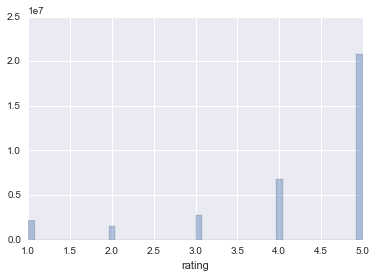

In [10]:
ratings=full_rating_table["rating"]
sns.distplot(ratings,kde=False)


 Now, we would like to study the ditribution of the number of ratings per user. This scale is very large, going from 1 to 43K ratings with a mean of 2.6 (i.e lots of users only rated 1 item, actually 7M of the 12M users) , The following histogram is realized on a logarithmic scale for both the number of ratings and the number of users for each scale,this was to avoid having a single bar histogram . The next thing we decided to do is filter out the ratings of the users who have more than 1000 ratings. From a human point of view, it sounds impossible for a human to buy over 1000 items from amazon (espaecially for the 43K ratings user), so we make the assumption that these ratings come from bots.

In [11]:
ratings_per_user=pd.value_counts(full_rating_table["user"])


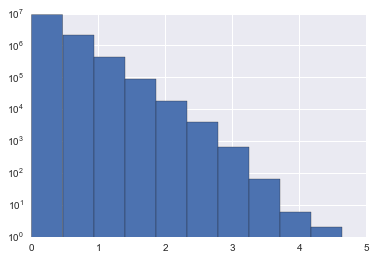

In [12]:
import pylab as pl
pl.hist(np.log10(ratings_per_user))
pl.gca().set_yscale("log")
pl.show()

In [17]:
discarded_users=list(ratings_per_user.where(ratings_per_user>1000).dropna(how="any").keys())
def isNotDiscarded(usr):
    return usr not in discarded_users

In [20]:
full_rating_table=full_rating_table[[isNotDiscarded(usr) for usr in full_rating_table["user"]]]

In [21]:
ratings_per_user_new=pd.value_counts(full_rating_table["user"])

In [23]:
ratings_per_item=pd.value_counts(full_rating_table["item"])


The rating for the item are depicted below. Here again, the range is very large. The mean number of ratings for a movie is 10, so the movies rated only once are much rarer. The range goes from 1 to 21373.The latter is less of an "outlier" than the maximum for the users as there are more items that have been rated nearly as much as the most popular item (1610 items have over 1000 ratings against 268 users, plus we removed these).

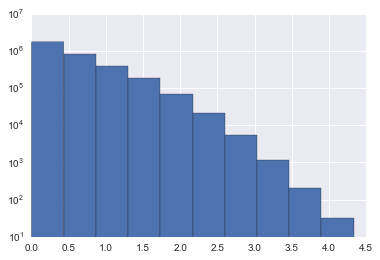

In [25]:
pl.hist(np.log10(ratings_per_item))
pl.gca().set_yscale("log")
pl.show()


In [31]:
ratings_per_item.where(ratings_per_item>1000).dropna(how="any").shape

(1610,)

Let's see how sparse is our data by plotting the user-item adjacency matrix. The sparser it is, the less appropriate will be the collaborative filtering method. 

In [36]:
items=full_rating_table["item"].unique()
users=full_rating_table["user"].unique()
item2index=dict()
user2index=dict()
for i in range(len(items)):
    item2index[items[i]]=i
for j in range(len(users)):
    user2index[users[j]]=j

In [37]:
copy_df=full_rating_table
copy_df["asindex"]=[item2index[b] for b in copy_df["item"]]
copy_df["userindex"]=[user2index[u] for u in copy_df["user"]]


In [38]:
copy_df=copy_df.drop(["item","user"],axis=1)


In [17]:
copy_df=copy_df.drop(["overall"],axis=1)

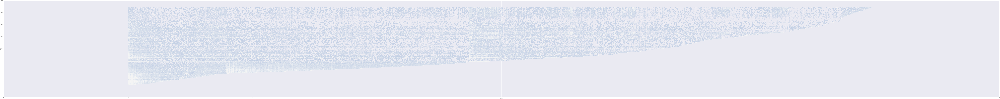

In [42]:
sns.pairplot(copy_df,x_vars="userindex",y_vars="asindex",aspect=10,size=25,plot_kws={"s": 1})


As we can see, the adjacency matrix is very sparse, due mostly to the users rating very few items (7 Million have rated 1 ). This means collaborative filtering alone will not give predictions accurate enough and that we will have to implemet other methods (description based for instance) in order to infer neighborhood between items. 